In [2]:
import cv2
import os
import mediapipe as mp
import pickle
import random
import matplotlib.pyplot as plt
import numpy as np
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score

In [2]:
data_dir = "C:/Users/KIIT/PycharmProjects/sign_lang/asl_alphabet_train"#path to data directory

In [3]:
mp_hands = mp.solutions.hands 
mp_drawing = mp.solutions.drawing_utils 
mp_drawing_styles = mp.solutions.drawing_styles 
hands = mp_hands.Hands(static_image_mode = True, min_detection_confidence = 0.3)

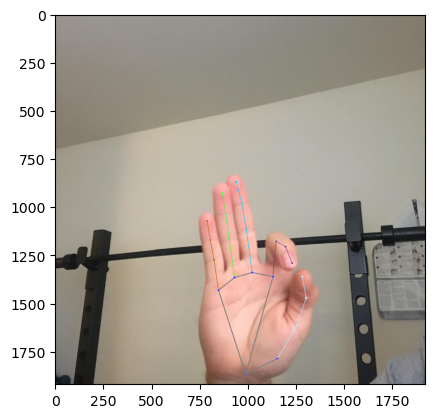

In [4]:
img1 = cv2.imread("C:/Users/KIIT/PycharmProjects/sign_lang/asl_alphabet_train/F/3.jpg")
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB) 
res1 = hands.process(img1)
if res1.multi_hand_landmarks:
    for hand_landmarks in res1.multi_hand_landmarks:
        mp_drawing.draw_landmarks(img1, 
                                  hand_landmarks,
                                 mp_hands.HAND_CONNECTIONS,
                                 mp_drawing_styles.get_default_hand_landmarks_style(),
                                 mp_drawing_styles.get_default_hand_connections_style())
plt.imshow(img1)

In [4]:
def load_encodings(file_path):
    with open(file_path, 'rb') as file:
        return pickle.load(file)

def save_encodings(data, file_path):
    with open(file_path, 'wb') as file:
        pickle.dump(data, file)

In [5]:
encodeDict1 = {}
if os.path.exists('handencodings1.pickle'):
    encodeDict1 = load_encodings('handencodings1.pickle')

In [7]:
for alphabet_folder in os.listdir(data_dir):
    alphabet_path = os.path.join(data_dir, alphabet_folder)
    if os.path.isdir(alphabet_path):
        if alphabet_folder not in encodeDict1:
            encodeDict1[alphabet_folder] = []
            image_files = os.listdir(alphabet_path)

            for image_file in image_files:
                img_path = os.path.join(alphabet_path, image_file)
                img = cv2.imread(img_path)
                if img is None:
                    print(f"Unable to read image: {img_path}")
                    continue
                
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                res = hands.process(img)
                if not res.multi_hand_landmarks:
                    print(f"Hand not detected in {img_path}")
                else:
                    print(f"Hand detected in {img_path}")
                    for hand_landmarks in res.multi_hand_landmarks:
                        arr = []
                        x_lmrk = [landmark.x for landmark in hand_landmarks.landmark]
                        y_lmrk = [landmark.y for landmark in hand_landmarks.landmark]
                        for landmark in hand_landmarks.landmark:
                            arr.append(landmark.x - min(x_lmrk))
                            arr.append(landmark.y - min(y_lmrk))
                        encodeDict1[alphabet_folder].append(arr)  # Append landmarks to the list

# Save the encodings
def save_encodings(encodeDict, filename):
    with open(filename, 'wb') as f:
        pickle.dump(encodeDict, f)

save_encodings(encodeDict1, 'handencodings1.pickle')

Hand detected in C:/Users/KIIT/PycharmProjects/sign_lang/asl_alphabet_train\A\1.jpg
Hand detected in C:/Users/KIIT/PycharmProjects/sign_lang/asl_alphabet_train\A\10.jpg
Hand detected in C:/Users/KIIT/PycharmProjects/sign_lang/asl_alphabet_train\A\100.jpg
Hand detected in C:/Users/KIIT/PycharmProjects/sign_lang/asl_alphabet_train\A\101.jpg
Hand detected in C:/Users/KIIT/PycharmProjects/sign_lang/asl_alphabet_train\A\102.jpg
Hand detected in C:/Users/KIIT/PycharmProjects/sign_lang/asl_alphabet_train\A\103.jpg
Hand detected in C:/Users/KIIT/PycharmProjects/sign_lang/asl_alphabet_train\A\104.jpg
Hand detected in C:/Users/KIIT/PycharmProjects/sign_lang/asl_alphabet_train\A\105.jpg
Hand detected in C:/Users/KIIT/PycharmProjects/sign_lang/asl_alphabet_train\A\106.jpg
Hand detected in C:/Users/KIIT/PycharmProjects/sign_lang/asl_alphabet_train\A\107.jpg
Hand detected in C:/Users/KIIT/PycharmProjects/sign_lang/asl_alphabet_train\A\108.jpg
Hand detected in C:/Users/KIIT/PycharmProjects/sign_lang/

In [6]:
encodeDict1.keys()

dict_keys(['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z'])

In [7]:
data = []
labels = []
for label, landmarks in encodeDict1.items():
    for landmark in landmarks:
        data.append(landmark)
        labels.append(label)

In [8]:
data = np.array(data)
labels = np.array(labels)

In [9]:
label_encoder = LabelEncoder()
labels_encoded = label_encoder.fit_transform(labels)

In [10]:
X_train_val, X_test, y_train_val, y_test = train_test_split(data, labels_encoded, test_size=0.3, random_state=42)

In [11]:
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.2, random_state=42)

In [12]:
model = RandomForestClassifier(n_estimators=50, random_state=42)
model.fit(X_train, y_train)

RandomForestClassifier(n_estimators=50, random_state=42)

In [14]:
y_test_pred = model.predict(X_test)
test_accuracy = accuracy_score(y_test, y_test_pred)
print(f'Test Accuracy: {test_accuracy * 100:.2f}%')

Test Accuracy: 98.75%


In [13]:
y_val_pred = model.predict(X_val)
val_accuracy = accuracy_score(y_val, y_val_pred)
print(f'Validation Accuracy: {val_accuracy * 100:.2f}%')

Validation Accuracy: 98.85%


In [15]:
print('Classification Report (Test Set):')
print(classification_report(y_test, y_test_pred))

Classification Report (Test Set):
              precision    recall  f1-score   support

           0       0.98      0.99      0.98      1693
           1       0.99      1.00      0.99      1823
           2       0.97      0.99      0.98      1638
           3       1.00      0.99      0.99      1867
           4       0.98      0.99      0.98      1664
           5       0.99      1.00      0.99      2396
           6       0.98      0.99      0.99      1929
           7       0.99      0.98      0.99      1808
           8       0.99      0.99      0.99      1803
           9       0.99      0.99      0.99      1787
          10       0.99      0.99      0.99      2090
          11       1.00      1.00      1.00      2021
          12       0.95      0.97      0.96      1398
          13       0.98      0.94      0.96      1040
          14       0.99      0.98      0.99      1685
          15       0.99      0.99      0.99      1521
          16       0.98      0.99      0.99    

In [17]:
with open('signLangModel_final.pickle', 'wb') as file:
    pickle.dump(model, file)

In [18]:
with open('label_encoder_final.pickle', 'wb') as file:
    pickle.dump(label_encoder, file)

In [19]:
with open('signLangModel_final.pickle', 'rb') as file:
    model = pickle.load(file)

In [20]:
with open('label_encoder_final.pickle', 'rb') as file:
    label_encoder = pickle.load(file)

In [21]:
cap = cv2.VideoCapture(0)

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    img_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    result = hands.process(img_rgb)
    if result.multi_hand_landmarks:
        for hand_landmarks in result.multi_hand_landmarks:
            landmarks = hand_landmarks.landmark
            x_lmrk = [landmark.x for landmark in landmarks]
            y_lmrk = [landmark.y for landmark in landmarks]
            features = []
            for landmark in landmarks:
                features.append(landmark.x - min(x_lmrk))
                features.append(landmark.y - min(y_lmrk))

            features = np.array(features).reshape(1, -1)

            prediction = model.predict(features)
            predicted_class = label_encoder.inverse_transform(prediction)[0]
            
            img_h, img_w, _ = frame.shape
            x_min = int(min(x_lmrk) * img_w)
            y_min = int(min(y_lmrk) * img_h)
            x_max = int(max(x_lmrk) * img_w)
            y_max = int(max(y_lmrk) * img_h)
            
            cv2.rectangle(frame, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)
            cv2.putText(frame, f'Predicted: {predicted_class}', (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2, cv2.LINE_AA)

            mp_drawing.draw_landmarks(frame, hand_landmarks, mp_hands.HAND_CONNECTIONS)

    cv2.imshow('Sign Language Interpreter', frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break
        
cap.release()
cv2.destroyAllWindows()